In [1]:
%matplotlib inline
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
import caffe

/mnt/antares_raid/home/oliver/adhara/src/caffe/python/caffe/pycaffe.py:13: RuntimeWarning: to-Python converter for boost::shared_ptr<caffe::Net<float> > already registered; second conversion method ignored.
  from ._caffe import Net, SGDSolver, NesterovSolver, AdaGradSolver, \
/mnt/antares_raid/home/oliver/adhara/src/caffe/python/caffe/pycaffe.py:13: RuntimeWarning: to-Python converter for boost::shared_ptr<caffe::Blob<float> > already registered; second conversion method ignored.
  from ._caffe import Net, SGDSolver, NesterovSolver, AdaGradSolver, \
/mnt/antares_raid/home/oliver/adhara/src/caffe/python/caffe/pycaffe.py:13: RuntimeWarning: to-Python converter for boost::shared_ptr<caffe::Solver<float> > already registered; second conversion method ignored.
  from ._caffe import Net, SGDSolver, NesterovSolver, AdaGradSolver, \


In [50]:
def sigmoid(z):
    s = 1.0 / (1.0 + np.exp(-1.0 * z))
    return s


In [2]:

net_R = caffe.Net('/mnt/antares_raid/home/oliver/Experiments/N25R/deploy_net.prototxt',
                '/mnt/antares_raid/home/oliver/Experiments/N25R/snapshots/_iter_780000.caffemodel',
                caffe.TEST)

In [62]:


def vis_square(data, title):
    data -= data.min()
    data /= data.max()
    
    # force the number of filters to be square
    n = int(np.ceil(np.sqrt(data.shape[0])))
    print(n)
    # tile the filters into an image
    #data = data.reshape((n,n*data.shape[1]))
    
    
      # tile the filters into an image
    #data = data.reshape((n, n) + (n,n))
    plt.figure(figsize=(28,28))
   # data = data.reshape((n * data.shape[1], n * data.shape[3]) + data.shape[4:])
    for i in range(784):
        plt.subplot(28,28,i+1)
        plt.axis('off')
        ax = plt.gca()
        ax.imshow(data[i,:].reshape((n,n)))
    plt.show()

def vis_layer_neuron(caffemodel, deploy_net_dir, layer,  neuron_list):
    net_R = caffe.Net(deploy_net_dir,
                    caffemodel, caffe.TEST)
    data = net_R.params[layer][0].data
    data -= data.min()
    data /= data.max()
    
    plt.figure(figsize=(20,10))
    for i,neuron in enumerate(neuron_list):
        net_R = caffe.Net(deploy_net_dir,
                    caffemodel, caffe.TEST)

        
        plt.subplot(1,len(neuron_list),i+1)
        plt.axis('off')
        ax = plt.gca()
        ax.imshow(data[neuron,:].reshape((28,28)))
        plt.title('Neuron {}'.format(neuron))
    plt.show()

def vis_layer_evolution(initial, snapshot_dir, deploy_net_dir, layer,  neuron_nr):
    import glob
    
    caffemodels = glob.glob('%s*.caffemodel'%snapshot_dir)
    caffemodels = initial +(caffemodels)
    plt.figure(figsize=(20,10))
    
    caffemodels =caffemodels[::10]
    for i,model in enumerate(caffemodels):
        net_R = caffe.Net(deploy_net_dir,
                    model, caffe.TEST)
        data = net_R.params[layer][0].data
        data -= data.min()
        data /= data.max()
        plt.subplot(1,len(caffemodels),i+1)
        plt.axis('off')
        ax = plt.gca()
        ax.imshow(data[neuron_nr,:].reshape((28,28)))
    plt.show()
        
        
    


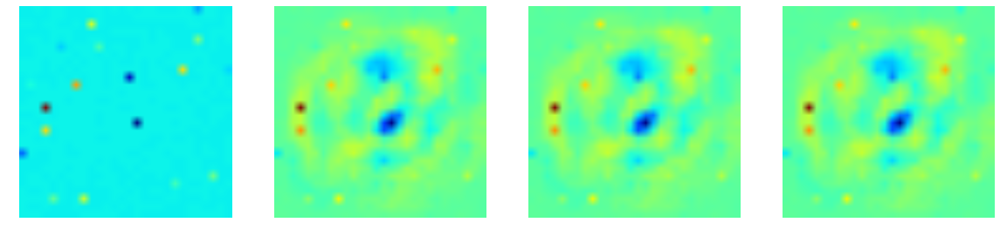

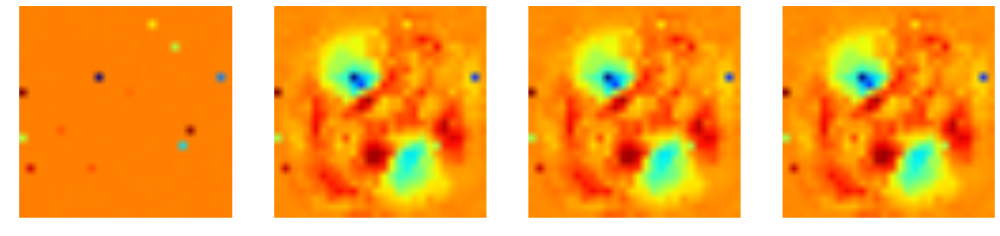

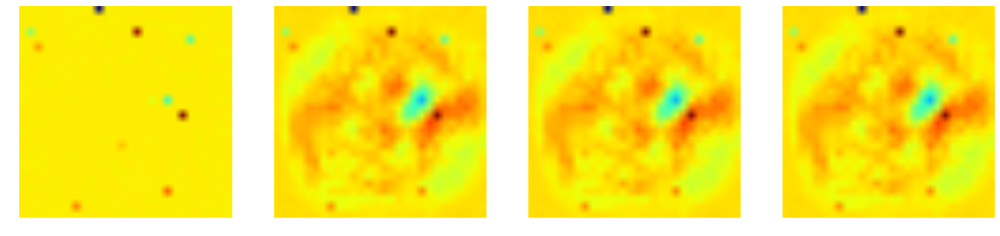

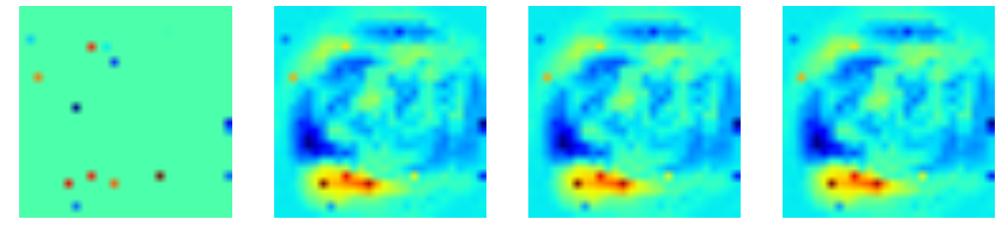

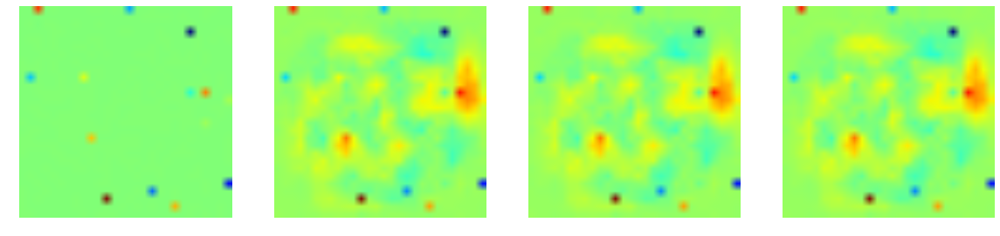

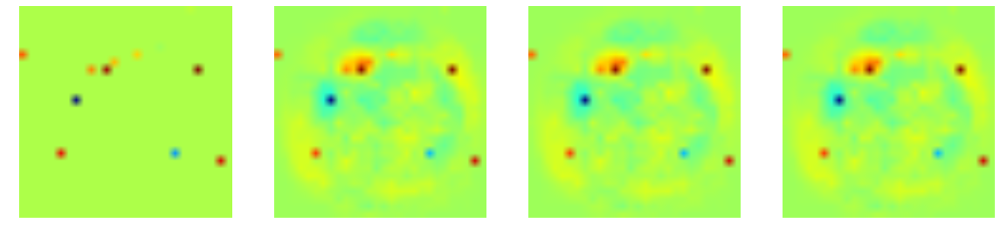

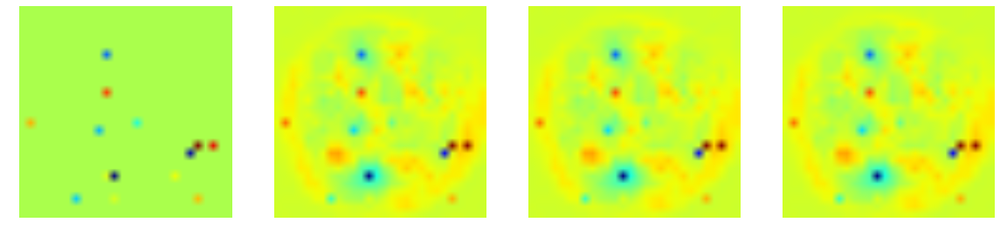

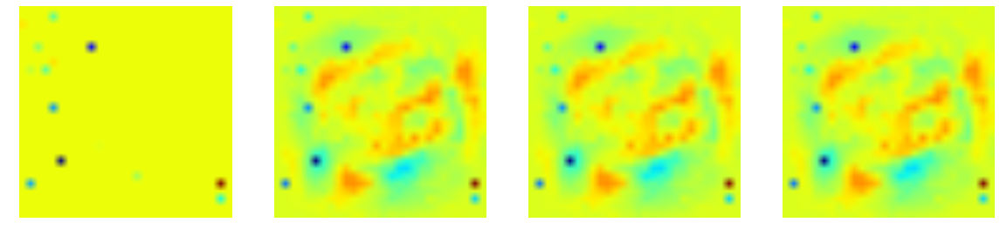

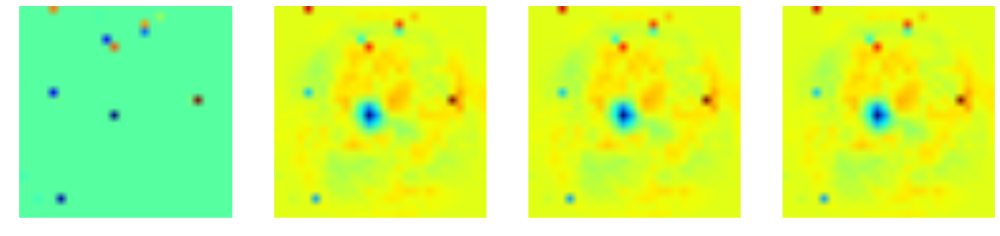

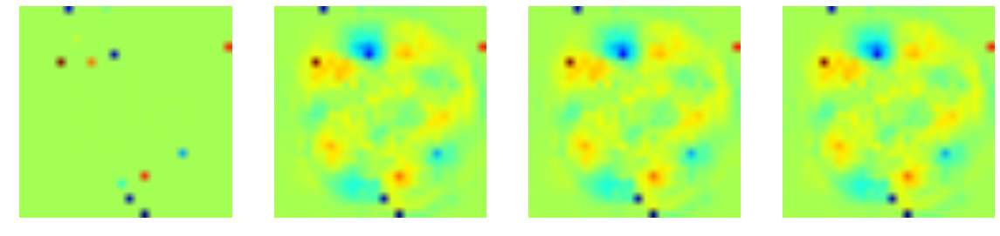

In [66]:
date = '2008'
snap = '390000'

initial = '/mnt/antares_raid/home/oliver/Experiments/2008/Initial_weights/_iter_1.caffemodel'
snapshot_dir = '/mnt/antares_raid/home/oliver/Experiments/{}/N50NR/snapshots/'.format(date)
deploy_net_dir = '/mnt/antares_raid/home/oliver/Experiments/{}/N50NR/deploy_net.prototxt'.format(date)
layer = 'encode1'
for i in range(10):
    vis_layer_evolution([initial],snapshot_dir, deploy_net_dir, layer,  i)

Rotated


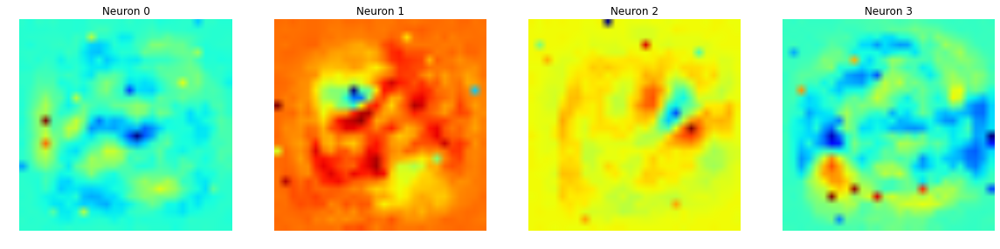

Unrotated


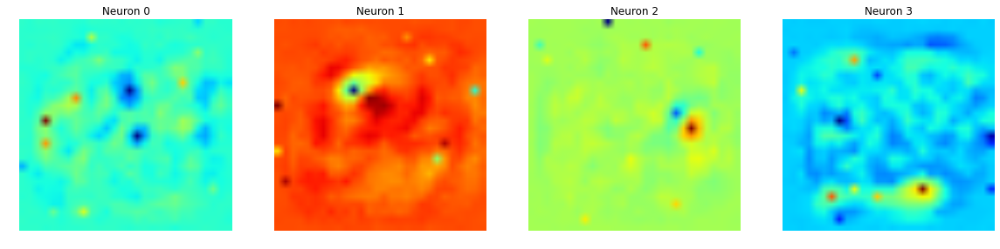

Noisy Rotated 25%


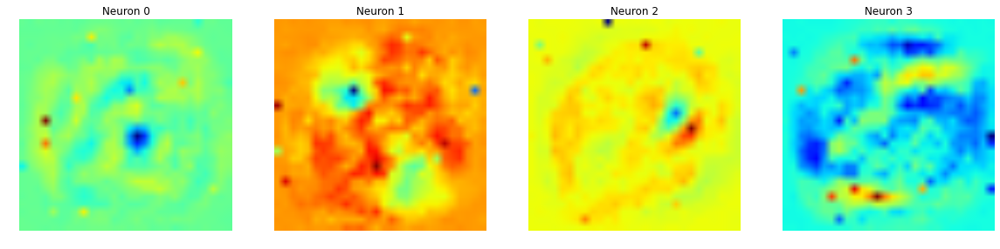

Noisy Unrotated 25%


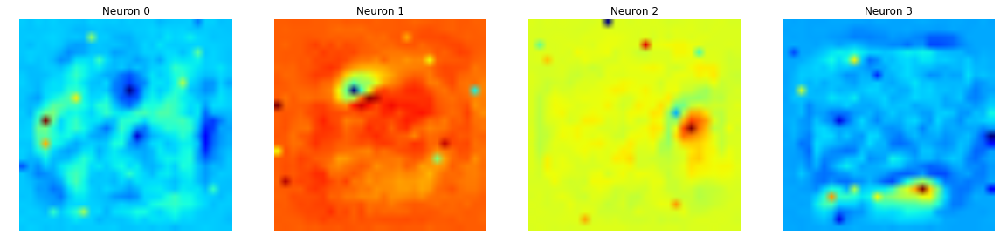

Noisy Rotated 50%


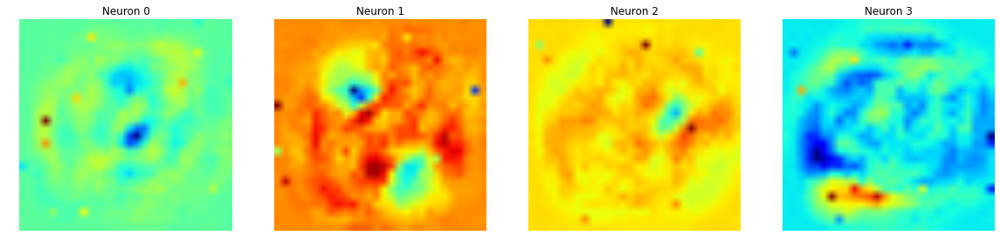

Noisy Unrotated 50%


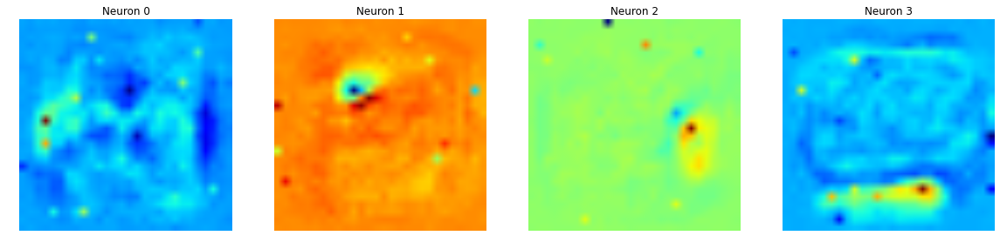

In [34]:
#Test vis_layer_neuron
date = '2008'
snap = '390000'
caffemodels =  ['/mnt/antares_raid/home/oliver/Experiments/{}/R/snapshots/_iter_{}.caffemodel'.format(date,snap),
                '/mnt/antares_raid/home/oliver/Experiments/{}/UR/snapshots/_iter_{}.caffemodel'.format(date,snap),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N25NR/snapshots/_iter_{}.caffemodel'.format(date,snap),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N25NUR/snapshots/_iter_{}.caffemodel'.format(date,snap),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N50NR/snapshots/_iter_{}.caffemodel'.format(date,snap),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N50NUR/snapshots/_iter_{}.caffemodel'.format(date,snap)
                ]
deploy_net_dirs = ['/mnt/antares_raid/home/oliver/Experiments/{}/R/deploy_net.prototxt'.format(date),
                '/mnt/antares_raid/home/oliver/Experiments/{}/UR/deploy_net.prototxt'.format(date),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N25NR/deploy_net.prototxt'.format(date),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N25NUR/deploy_net.prototxt'.format(date),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N50NR/deploy_net.prototxt'.format(date),
                '/mnt/antares_raid/home/oliver/Experiments/{}/N50NUR/deploy_net.prototxt'.format(date),
                ]
                   
labels = ["Rotated", 'Unrotated', 'Noisy Rotated 25%', 'Noisy Unrotated 25%','Noisy Rotated 50%' , 'Noisy Unrotated 50%' ]                   
layer = 'encode1'
neuron_list = [0,1,2,3 ]#,5,6,7,8,9,10,11,12,13,14,15]


for i,caffemodel, deploy_net_dir in zip(range(len(labels)),caffemodels,deploy_net_dirs): 
    print(labels[i])
    vis_layer_neuron(caffemodel, deploy_net_dir, layer,  neuron_list)

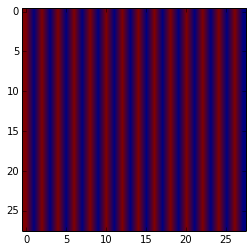

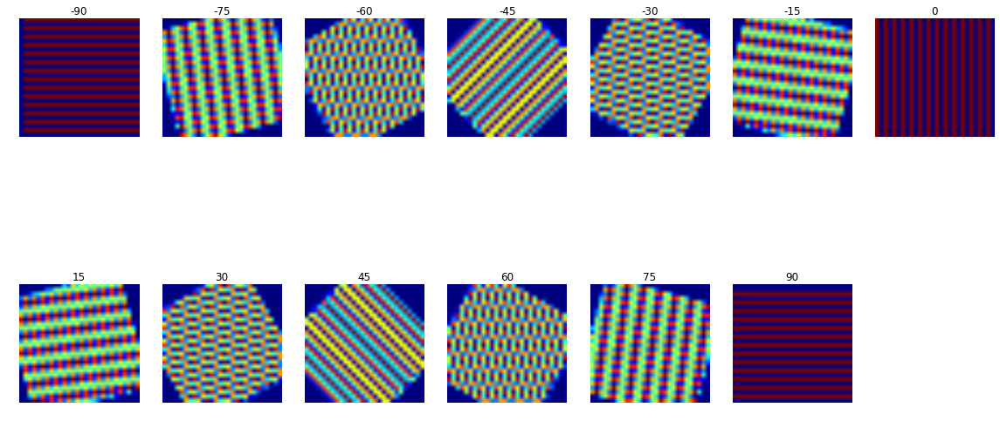

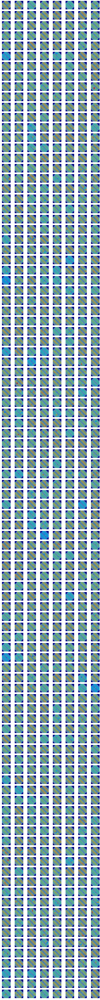

In [60]:
import cv2

dummy = np.zeros((28,28))
dummy[:, ::2] = 1
plt.imshow(dummy)
plt.show()


net_R = caffe.Net('/mnt/antares_raid/home/oliver/Experiments/N25R/deploy_net.prototxt',
                '/mnt/antares_raid/home/oliver/Experiments/N25R/snapshots/_iter_780000.caffemodel',
                caffe.TEST)
data = net_R.params['encode1'][0].data
data -= data.min()
data /= data.max()

cols,rows = 28,28
angles = range(-90,90+1,15)
plt.figure(figsize=(20,10))
for i,angle in enumerate(angles):
    plt.subplot(2,np.ceil(len(angles)/2)+1,i+1)
    plt.axis('off')
    M = cv2.getRotationMatrix2D((cols/2,rows/2),angle,1)
   # print(angle,M)
    plt.title(angle)
    plt.imshow(cv2.warpAffine(dummy,M,(28,28)))
plt.show()


angle = 45
M = cv2.getRotationMatrix2D((cols/2,rows/2),angle,1)
dummy_rot = cv2.warpAffine(dummy,M,(28,28))


plt.figure(figsize=(20,200))
for i in range(layer1.shape[0]):
    plt.subplot(98,8,i+1)
    plt.axis('off')
    dat = data[i,:].reshape((28,28))*dummy_rot
    plt.imshow(sigmoid(dat))

plt.show()

                      
                          



In [141]:
net_R = caffe.Net('/mnt/antares_raid/home/oliver/Experiments/N25R/deploy_net.prototxt',
                '/mnt/antares_raid/home/oliver/Experiments/N25R/snapshots/_iter_780000.caffemodel',
                caffe.TEST)

dummy = np.zeros((28,28))
for i in range(6,21):
    ind = abs(i-25)
    dummy[ind,i] = 255
    dummy[ind-1,i] = 200
    dummy[ind+1,i] = 200
    dummy[ind-2,i] = 100
    dummy[ind+2,i] = 100
    dummy[ind-3,i] = 17
    dummy[ind+3,i] = 17
#dummy = np.eye(28)*255


#dummy = I[18].squeeze()
# copy the image data into the memory allocated for the net
net_R.blobs['data'].data[...] = dummy.T

### perform classification
output = net_R.forward()

output['decode1neuron']



array([[ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358],
       [ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358],
       [ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358],
       ..., 
       [ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358],
       [ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358],
       [ 0.00019484,  0.00012311,  0.0001048 , ...,  0.00012355,
         0.00013234,  0.00013358]], dtype=float32)

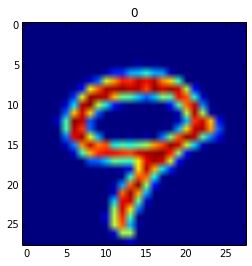

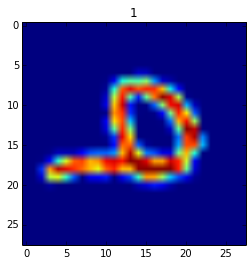

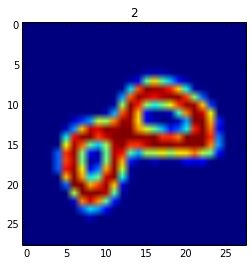

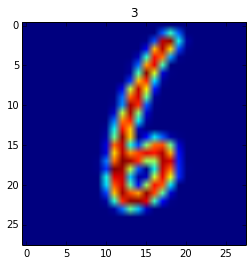

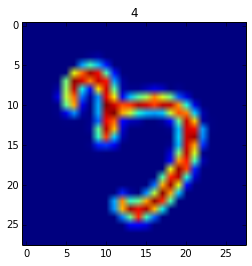

...

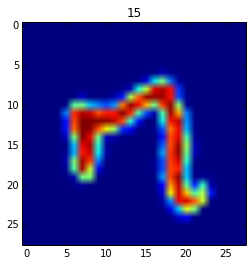

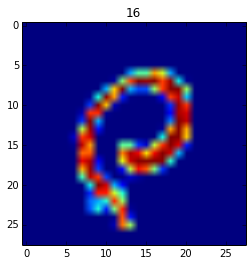

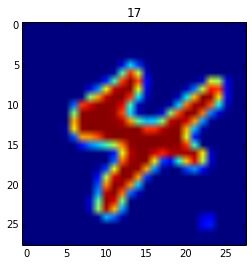

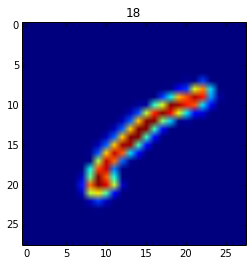

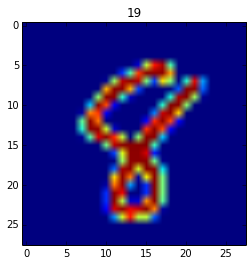

In [109]:
import lmdb
path = '/mnt/antares_raid/home/oliver/Experiments/lmdbs/MNIST_TEST_10000_rot_lmdb/shuffled'

lmdb_env = lmdb.open(path)
lmdb_txn = lmdb_env.begin()
lmdb_cursor = lmdb_txn.cursor()
datum_db = caffe.proto.caffe_pb2.Datum()
I = []
Label = []
im_count = 0
for key, value in lmdb_cursor:
        datum_db.ParseFromString(value)
        label = datum_db.label
        data = caffe.io.datum_to_array(datum_db)
        im = data.astype(np.uint8)
        im = np.transpose(im, (2, 1, 0)) # original (dim, col, row)
        plt.imshow(im.squeeze())
        plt.title(im_count)
        plt.show()
        I.append(im)
        im_count = im_count + 1
        if im_count == 20:
            break

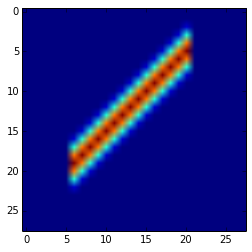

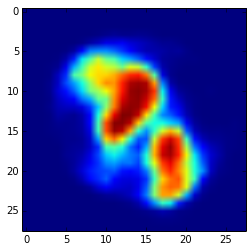

In [142]:

plt.imshow(dummy)
plt.show()

plt.imshow(output['decode1neuron'][1,:].reshape(28,28).T)
plt.show()

{'branch_pages': 28L, 'leaf_pages': 5417L, 'overflow_pages': 780000L, 'psize': 4096L, 'depth': 3L, 'entries': 780000L}


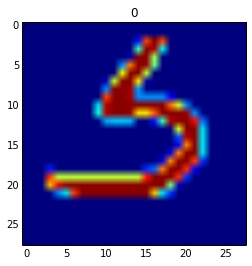

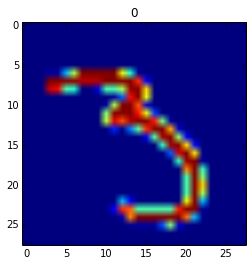

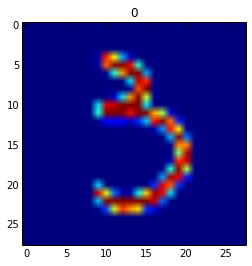

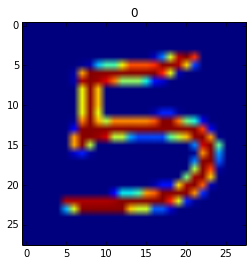

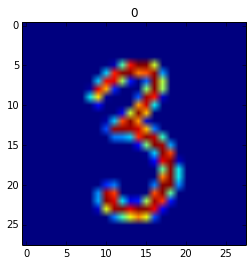

...

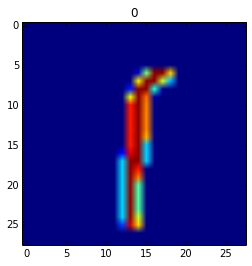

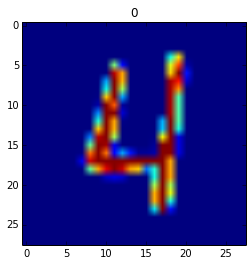

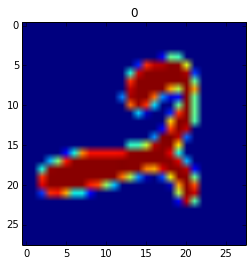

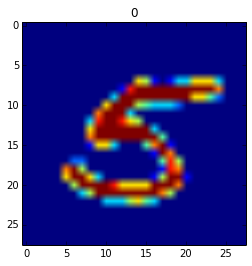

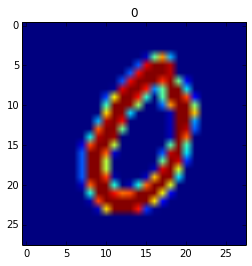

KeyboardInterrupt: 

In [145]:
import lmdb
path = '/mnt/antares_raid/home/oliver/Experiments/lmdbs/MNIST_TRAIN_60000_unrot_lmdb/shuffled'

lmdb_env = lmdb.open(path)
lmdb_txn = lmdb_env.begin()
lmdb_cursor = lmdb_txn.cursor()
datum_db = caffe.proto.caffe_pb2.Datum()
print(lmdb_env.stat())
I = []
Label = []
im_count = 0
for key, value in lmdb_cursor:
        datum_db.ParseFromString(value)
        label = datum_db.label
        data = caffe.io.datum_to_array(datum_db)
        im = data.astype(np.uint8)
        im = np.transpose(im, (2, 1, 0)) # original (dim, col, row)
        plt.imshow(im.squeeze())
        plt.title(im_count)
        plt.show()